# Рынок заведений общественного питания Москвы

Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены. Необходимо проанализировать рынок Москвы, выявить интересные закономерности и предложить заказчикам лучшее место для открытия заведения.

## Описание данных:
* `name` — название заведения;
* `address` — адрес заведения;
* `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
* `hours` — информация о днях и часах работы;
* `lat` — широта географической точки, в которой находится заведение;
* `lng` — долгота географической точки, в которой находится заведение;
* `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
* `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
* `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона;
* `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»;
* `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»;
* `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки);
* `district` — административный район, в котором находится заведение, например Центральный административный округ;
* `seats` — количество посадочных мест.

## План работы над проектом:
* Подлючить нужные библиотеки, открыть и ознакомиться с данными;
* Предобработка данных: проверка типов данных, устранение пропусков и дубликатов, добавление новых столбцоы;
* Исследовательский анализ данных: выявить закономерности в данных, сделать выводы;
* Детализация исследования;
* Подготовка презентации.

## Основные задачи проекта:
* Найти интересные особенности, которые в будущем помогут в выборе подходящего инвесторам места;
* Выяснить в каких районах наибольшее кол-во кафе, определить особенности их расположения;
* Получить исследовательский вывод, на основание которого заказчик определится с типом заведения и его расположением.

## Оглавление
1. [Открытие данных](#start)
2. [Предобработка данных](#pred)
    * [Проверка типа данных в датафрейме](#prov_tip)
    * [Изучение пропусков в датафрейме](#propus)
    * [Создадание столбца с названиями улиц](#street)
    * [Создадание столбца с обозначением ежедневной и круглосуточной работой заведения](#is_24/7)
3. [Анализ данных](#3)
    * [Количество заведений по категориям](#3.1.)
    * [Количество посадочных мест по категориям](#3.2.)
    * [Cоотношение сетевых и несетевых заведений](#3.3.)
    * [Категории сетевых заведений](#3.4.)
    * [Топ-15 популярных сетей в Москве](#3.5.)
    * [Категории заведений в  административных районах Москвы](#3.6.)
    * [Распределение средних рейтингов по категориям заведений](#3.7.)
    * [Фоновая картограмма со средним рейтингом заведений каждого района](#3.8.)
    * [Отображение всех заведений датасета на карте с помощью кластеров](#3.9.)
    * [Топ-15 улиц по количеству заведений](#3.10.)
    * [Значение среднего чека по районам](#3.11.)
    * [Выводы исследования](#v)
4. [Детализируем исследование: открытие кофейни](#4.)
    * [Количество кофеен в датасете](#4.1.)
    * [Круглосуточные кофейни](#4.2.)
    * [Рейтинг кофеен](#4.3.)
    * [Ориентировочная цена за чашку капучино](#4.4.)
    * [Рекомендации по открытию кофейни](#rec)
5. [Презентация](#prez)

### 1. Откроем файл с  данными и изучим общую информацию
<a id="start"></a> 

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from plotly import graph_objects as go
from folium import Map, Marker, Choropleth
from folium.plugins import MarkerCluster
import json
import plotly.express as px

In [2]:
try:
    df = pd.read_csv('C:\data\moscow_places.csv', sep=',')
except:
    df = pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv', sep=',')

In [3]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Всего в таблице представлено 5614 уникальных заведений, в том числе сетевых.

In [4]:
df['name'].nunique()

5614

### 2. Предобработка данных
<a id="pred"></a> 

### 2.1. Проверим типы данных в датафрейме:
<a id="prov_tip"></a> 

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


В таблице 14 столбцов и 8406 строк. Тип данных во всех столбцах узакан корректно, кроме столбца `seats`. Изменим тип данных с float на int:

In [6]:
df['seats'] = df['seats'].convert_dtypes()

### 2.2. Изучим пропуски в датафрейме и, при необходимости, заполним их:
<a id="propus"></a> 

In [7]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [8]:
def gaps_in_dataframe(df):
    try:
        (
            (df.isna().mean()*100)
            .to_frame()
            .rename(columns = {0:'space'})
            .query('space > 0')
            .sort_values(by = 'space', ascending = True)
            .plot(kind= 'barh', figsize=(19,6), rot = -5, legend = False, fontsize = 16)
            .set_title('Пропуски в датафрйме, %' + "\n", fontsize = 22, color = 'SteelBlue')    
        );    
    except:
        print('пропусков нет')

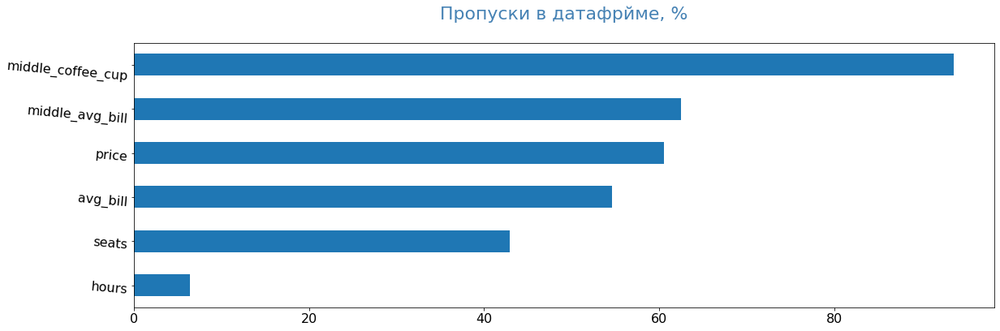

In [9]:
gaps_in_dataframe(df)

Количество пропусков в столбце `hours` cоставляет менее 10 %, поэтому на анализ пропуски не повлияют. Другие столбцы имеют большое количество пропусков, но заполнить их не получится, т.к. логической закономерности с другми столбцами они не имеют. Для удобства заполним пропуски в этих столбцах "заглушками" - undefined.

In [10]:
df['price'] = df['price'].fillna('undefined')
df['avg_bill'] = df['avg_bill'].fillna('undefined')

### Проверка на явные и неявные дубликаты

In [11]:
print(f'Явных дубликатов: {df.duplicated().sum()}')

Явных дубликатов: 0


Приведем столбцы `name`, `address` к нижнему регистру:

In [12]:
df['name'] = df['name'].str.lower()
df['address'] = df['address'].str.lower()

Проверим эти столбцы на наличие неявных дубликатов:

In [13]:
df[df['name'].duplicated(keep=False)].sort_values('name').head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
5069,10 идеальных пицц,ресторан,"москва, улица большие каменщики, 9се",Центральный административный округ,"ежедневно, 11:45–22:30",55.738074,37.656047,4.3,undefined,undefined,NaN,NaN,1,<NA>
7590,10 идеальных пицц,ресторан,"москва, улица паустовского, 6, корп. 1",Юго-Западный административный округ,"ежедневно, 11:45–22:30",55.600224,37.539004,4.3,undefined,undefined,NaN,NaN,1,150
430,10 идеальных пицц,ресторан,"москва, улица свободы, 48, стр. 1",Северо-Западный административный округ,"ежедневно, круглосуточно",55.848528,37.454201,4.3,undefined,undefined,NaN,NaN,1,110
3282,18 грамм,кофейня,"москва, шелепихинская набережная, 34, корп. 2",Северо-Западный административный округ,"пн-пт 08:00–22:00; сб,вс 09:00–22:00",55.762761,37.509574,4.6,undefined,undefined,NaN,NaN,1,<NA>
4723,18 грамм,кофейня,"москва, набережная академика туполева, 15б",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–21:00",55.760838,37.681958,4.4,средние,Цена чашки капучино:100–200 ₽,NaN,150.0,1,<NA>


Видно, что название заведений дублируется, но это происходит по той причине, что в Москве существует несколько заведений на разных улицах.

In [14]:
df[df['address'].duplicated(keep=False)].sort_values('address').head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1260,жираф,кафе,"москва, 1-й волоколамский проезд, 10, стр. 1",Северо-Западный административный округ,пн-пт 08:00–20:00,55.804534,37.489640,4.3,средние,Средний счёт:350–550 ₽,450.0,NaN,1,100
1311,prime,ресторан,"москва, 1-й волоколамский проезд, 10, стр. 1",Северо-Западный административный округ,пн-пт 08:00–19:00,55.804294,37.490584,4.0,низкие,Средний счёт:400–600 ₽,500.0,NaN,1,100
4298,catcher,кафе,"москва, 1-й красногвардейский проезд, 19",Центральный административный округ,"ежедневно, 10:00–21:30",55.749773,37.535611,4.3,undefined,undefined,NaN,NaN,0,<NA>
4215,crystal cafe made in georgia,ресторан,"москва, 1-й красногвардейский проезд, 19",Центральный административный округ,"ежедневно, 11:00–23:00",55.750715,37.536180,4.3,высокие,Средний счёт:1500–3000 ₽,2250.0,NaN,0,<NA>
4054,ruski,ресторан,"москва, 1-й красногвардейский проезд, 21с2",Центральный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.749210,37.534179,4.7,высокие,Средний счёт:3000 ₽,3000.0,NaN,0,<NA>


Адреса тоже дублируются, но на этих адресах находятся разные заведения.

#### Вывод: в данных есть неявные дубликаты по названиям заведений, адресу, но удалять мы их не будем, т.к. в Москве много заведений, которые расположены по разным адресам, а также есть адреса, на которых расположено сразу несколько заведений.

### 2.3. Создадим столбец `street` с названиями улиц из столбца с адресом
<a id="street"></a> 

In [15]:
def first_value(i):
    try:
        values_list = i.split(',')
        return values_list[1]
    except:
        pass

df['street'] = df['address'].apply(first_value)

In [16]:
df['street'].value_counts(ascending=False)

 проспект мира                 184
 профсоюзная улица             122
 проспект вернадского          108
 ленинский проспект            107
 ленинградский проспект         95
                              ... 
 малый казённый переулок         1
 улица маршала соколовского      1
 улица максимова                 1
 басманный тупик                 1
 чонгарский бульвар              1
Name: street, Length: 1447, dtype: int64

В даннынх больше всего сведений о заведениях, которые расположены на улицах Проспект Мира, Профсоюзная и Проспект Вернадского.

### 2.4. Создадим столбец `is_24/7` с обозначением, что заведение работает ежедневно и круглосуточно (True - да, False - нет)
<a id="is_24/7"></a> 

In [17]:
df['hours'] = df['hours'].astype('str')

In [18]:
df['is_24/7'] = df['hours'].str.contains('ежедневно, круглосуточно')

In [19]:
df['is_24/7'].value_counts()

False    7676
True      730
Name: is_24/7, dtype: int64

### 3. Анализ данных
<a id="3"></a> 

### 3.1. Количество заведений по категориям в Москве
<a id="3.1."></a> 

In [20]:
share = df['category'].value_counts() 
share

кафе               2378
ресторан           2043
кофейня            1413
бар,паб             765
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

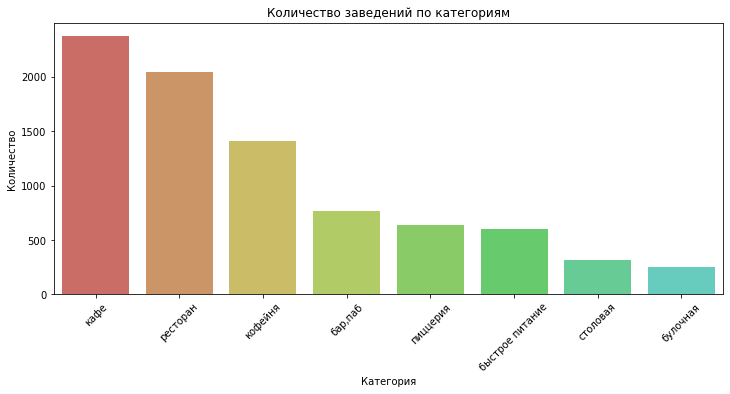

In [21]:
plt.figure(figsize=(12,5))
sns.set_palette('hls', 15) 
sns.barplot(x=share.index, y=share.values)

plt.xticks(rotation=45)
plt.title('Количество заведений по категориям')
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.show()

Больше всего в Москве заведений, которые отнсятся к категорям: кафе, ресторан и кофейня. Мешньше всего - булочных.

In [22]:
share = df['category'].value_counts(normalize=True) * 100
share

кафе               28.289317
ресторан           24.304069
кофейня            16.809422
бар,паб             9.100642
пиццерия            7.530335
быстрое питание     7.173448
столовая            3.747323
булочная            3.045444
Name: category, dtype: float64

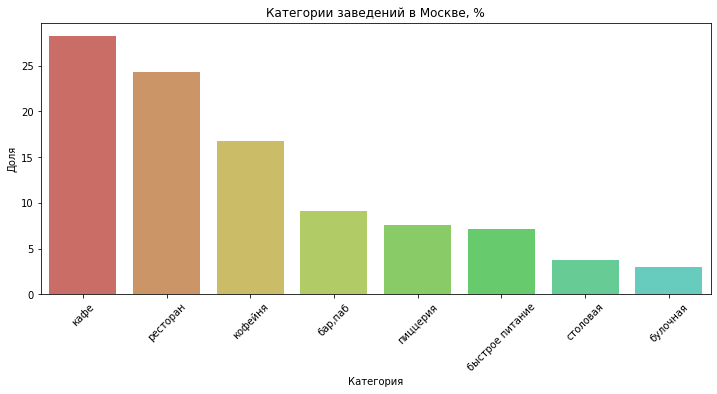

In [23]:
plt.figure(figsize=(12,5))
sns.set_palette('hls', 15) 
fig=sns.barplot(x=share.index, y=share.values)

plt.xticks(rotation=45)
plt.title('Категории заведений в Москве, %')
plt.xlabel('Категория')
plt.ylabel('Доля')
plt.show()

Категории "кафе", "ресторан" и "кофейня" составляют более 68 % всех категорий заведений, представленных в Москве.

### 3.2. Количество посадочных мест в местах по категориям
<a id="3.2."></a> 

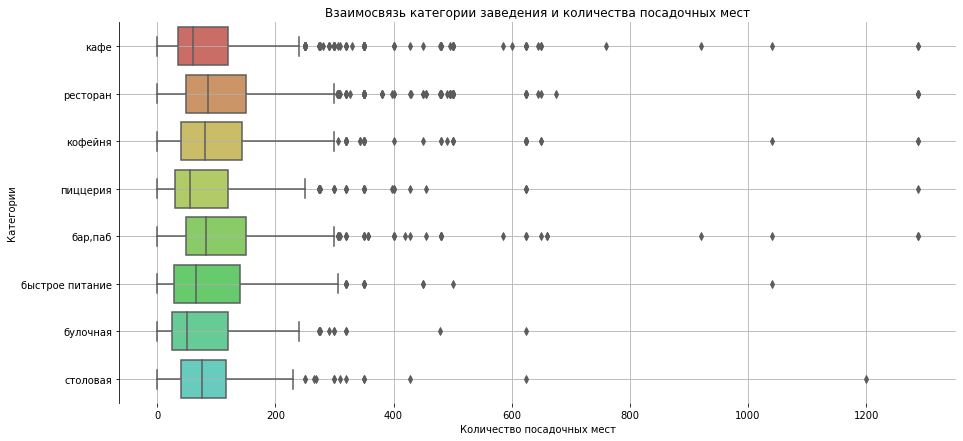

In [24]:
plt.figure(figsize=(15, 7))
sns.boxplot(x='seats', y='category', data=df) 
plt.xlabel('Количество посадочных мест')
plt.ylabel('Категории')
plt.grid()
plt.title('Взаимосвязь категории заведения и количества посадочных мест')
sns.despine(bottom = True)
plt.show()

In [25]:
category_seats = df.groupby('category')['seats'].agg(['mean', 'median']).sort_values(['mean', 'median'], ascending=False)
category_seats

,mean,median
category,,
"бар,паб",124.532051,82.5
ресторан,121.944094,86.0
кофейня,111.199734,80.0
столовая,99.75,75.5
быстрое питание,98.891117,65.0
кафе,97.512315,60.0
пиццерия,94.496487,55.0
булочная,89.385135,50.0


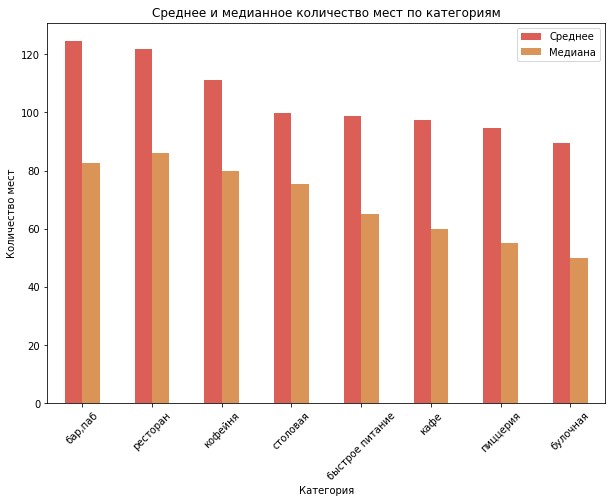

In [26]:
ax = category_seats.plot(kind='bar', 
                    figsize=(10, 7),
                    title='Среднее и медианное количество мест по категориям',
                    xlabel='Категория',
                    ylabel='Количество мест',
                    colormap= sns.set_palette('hls', 15))
ax.legend(['Среднее', 'Медиана'])
plt.xticks(rotation=45)
plt.show()

Из графика видно, что больше всего посадочных мест в барах, ресторанах и кофейнях. Среднее значение достаточно сильно отличается от медианного. Это может быть свзянао с тем, что в данных есть значения "выбросы", "выбросами" могут быть помещения с очень большим кол-ом мест: банкетные залы, двухэтажные заведения или с очень маленьким: заведения, которые работают на вынос.

### 3.3. Cоотношение сетевых и несетевых заведений в датасете
<a id="3.3."></a> 

In [27]:
count_chain = df['chain'].value_counts() # 1 - сетевое заведение, 0 - несетевое
count_chain

0    5201
1    3205
Name: chain, dtype: int64

In [28]:
labels = ['Несетевые', 'Сетевые']
fig = go.Figure(data=[go.Pie(labels=labels, values=count_chain.values)])
fig.update_layout(
    title=" Cоотношение сетевых и несетевых заведений",
    title_x = 0.5,
    margin=dict(l=0, r=0, t=30, b=0),
    legend_orientation="h")
fig.show() 

Более 61 % заведений в датасете - несетевые, это говорит о том, что предприниматели выбирают в большей степени развитие собственного бренда.

### 3.4. Категории сетевых заведений
<a id="3.4."></a> 

In [29]:
rest_grouped_category = (df.groupby('category', as_index=False)
                           .agg(count_object=('name', 'count')))

rest_grouped_chain = (df.query('chain == 1').groupby('category', as_index=False)
                        .agg(count_object=('name', 'count')))

rest_grouped_chain['ratio'] = round(rest_grouped_chain['count_object'] / rest_grouped_category['count_object'], 3) * 100
rest_grouped_chain = rest_grouped_chain.sort_values(by='ratio', ascending=False)
rest_grouped_chain

,category,count_object,ratio
1,булочная,157,61.3
5,пиццерия,330,52.1
4,кофейня,720,51.0
2,быстрое питание,232,38.5
6,ресторан,730,35.7
3,кафе,779,32.8
7,столовая,88,27.9
0,"бар,паб",169,22.1


In [30]:
fig = px.bar(rest_grouped_chain, x="category", y="ratio", title="Доля сетевых заведений от заведений каждого типа, %",
            labels={'category':'Категория', 'ratio':'Доля'}) #, text_auto=True)
fig.show()

Видно, что больше всего сетевых заведений в категории "булочная", далее идут почти в равной мере категории "пиццерия" и "кофейня".

### 3.5. Топ-15 популярных сетей в Москве
<a id="3.5."></a> 

In [31]:
df_network = df[df['chain'] == 1]
top_name = (df_network.groupby('name', as_index=False)['rating']
            .count().sort_values(by='rating', ascending=False)
            .rename(columns={'rating':'count'})
            .head(15))
top_name

,name,count
729,шоколадница,120
335,домино'с пицца,76
331,додо пицца,74
146,one price coffee,71
742,яндекс лавка,69
58,cofix,65
168,prime,50
664,хинкальная,44
409,кофепорт,42
418,кулинарная лавка братьев караваевых,39


In [32]:
fig = px.bar(top_name, x='name', y='count', title='Топ 15 сетевых заведений Москвы по количеству точек',\
             labels={'name':'Название сети', 'count':'Количество заведений'}) #, text_auto=True) 
fig.update_xaxes(tickangle=35) 
fig.layout.update(showlegend=False)
fig.show()

Наиболее популярные сетевые заведения в Москве по количеству - "Шоколадница", "Домино'с Пицца" и "Додо Пицца".

### Категории ТОП-15 заведений

In [33]:
top_name_list = top_name['name'].to_list()

In [34]:
top15_category = (df.loc[df['name'].isin(top_name_list)].groupby('category', as_index=False)
                              .agg(count_object=('name', 'count')))

top15_category['ratio'] = top15_category['count_object'] / top15_category['count_object'].sum() * 100
top15_category = top15_category.sort_values(by='ratio', ascending=False)
top15_category

,category,count_object,ratio
4,кофейня,337,41.198044
6,ресторан,186,22.738386
5,пиццерия,152,18.581907
3,кафе,100,12.224939
1,булочная,25,3.056235
2,быстрое питание,12,1.466993
0,"бар,паб",4,0.488998
7,столовая,2,0.244499


In [35]:
fig = px.bar(top15_category, x="category", y="ratio", title="Доля категорий по популярным сетям, %",
            labels={'category':'Категория', 'ratio':'Доля'})
fig.show()

Большенство поплурных заведений относятся к категорям "кофейня", "ресторан" и "пиццерия" и составляю 41%, 22% и 18% соответсвенно от общего числа заведений в этих категориях.

### 3.6. Категории заведений в  административных районах Москвы
<a id="3.6."></a> 

Районы, представленные в датасете:

In [36]:
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [37]:
distr_cat = (df.groupby('district', as_index=False)['category'].count()
              .sort_values(by='category')
              .rename(columns={"category": "count"}).reset_index(drop=True))
distr_cat

,district,count
0,Северо-Западный административный округ,409
1,Юго-Западный административный округ,709
2,Юго-Восточный административный округ,714
3,Восточный административный округ,798
4,Западный административный округ,851
5,Северо-Восточный административный округ,891
6,Южный административный округ,892
7,Северный административный округ,900
8,Центральный административный округ,2242


In [38]:
fig = px.bar(distr_cat, x='count', y='district',
             height=600,  
             title='Количество заведений в разных районах',
             labels={'district':'Район', 'count':'Количество'})
             #text_auto=True)
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

Больше всего заведений в ЦАО, центр города, ничего удивительного. В других районах количество заведений примерно равное и только в СЗАО заведений значительно меньше, чем в других районах.

### Распределение заведений в разрезе категорий по районам

In [39]:
top_district = (df.groupby(['district', 'category'], as_index=False)
                          .agg(count_object=('name', 'count')))

top_district['sum_object'] = top_district.groupby('district')['count_object'].transform(sum) 
top_district['ratio'] = round(top_district['count_object'] / top_district['sum_object'], 3) * 100
top_district

,district,category,count_object,sum_object,ratio
0,Восточный административный округ,"бар,паб",53,798,6.6
1,Восточный административный округ,булочная,25,798,3.1
2,Восточный административный округ,быстрое питание,71,798,8.9
3,Восточный административный округ,кафе,272,798,34.1
4,Восточный административный округ,кофейня,105,798,13.2
...,...,...,...,...,...
67,Южный административный округ,кафе,264,892,29.6
68,Южный административный округ,кофейня,131,892,14.7
69,Южный административный округ,пиццерия,73,892,8.2
70,Южный административный округ,ресторан,202,892,22.6


In [40]:
fig = px.bar(top_district, x='ratio', y='district',
             color='category',
             height=600,  title='Распределение заведений в разрезе категорий по районам, %',
             #,  text_auto=True,
             labels={'category':'Категория', 'ratio':'Доля', 'district':'Район'})
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

В сравнении заметно, что в ЦАО почти в 2 раза больше заведений "бар,паб", чем в других районах. Также, в ЦАО самая большая доля заведений в категории "ресторан". В ЮВАО самая большая доля заведений категории "кафе", но при этом самая маленькая доля заведений категории "булочная".

### 3.7. Распределение средних рейтингов по категориям заведений
<a id="3.7."></a>

In [41]:
rating_cat = df.groupby(['category'], as_index=False)['rating'].median().sort_values(by='rating',ascending=False)
rating_cat

,category,rating
0,"бар,паб",4.4
1,булочная,4.3
4,кофейня,4.3
5,пиццерия,4.3
6,ресторан,4.3
7,столовая,4.3
2,быстрое питание,4.2
3,кафе,4.2


In [42]:
fig = px.box(df, x='category', y='rating',
               color='category',
               labels={'category':'Категории', 'rating':'Рейтинг'}, height=750,
               title='Распределение средних рейтингов по категориям заведений')
fig.layout.update(showlegend=False)
fig.show() 

Самый высокий рейтинг у баров и пабов - 4.3. У пиццерий, ресторанов, кофейнь и булочных рейтинг примерно одинковый - 4.29-4.26, чуть меньше у столовых - 2.21. Самый низкий рейтинг у кафе и заведений быстрого питания - 4.12 и 4.05 соотвественно, это может быть связано с большим количеством поситителей и частой оценкой заведений.

### 3.8. Фоновая картограмма со средним рейтингом заведений каждого района
<a id="3.8."></a>

In [43]:
rating_df = df.groupby('district', as_index=False)['rating'].agg('mean').sort_values(by='rating', ascending=False)
rating_df

,district,rating
5,Центральный административный округ,4.377520
2,Северный административный округ,4.239778
4,Северо-Западный административный округ,4.208802
8,Южный административный округ,4.184417
1,Западный административный округ,4.181551
0,Восточный административный округ,4.174185
7,Юго-Западный административный округ,4.172920
3,Северо-Восточный административный округ,4.148260
6,Юго-Восточный административный округ,4.101120


In [44]:
try:
    with open(r'C:\data\admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
        geo_json = json.load(f)
except:
    with open('/datasets/admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)


# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=rating_df,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по округам',
).add_to(m)

# выводим карту
m

Самый высоий рейтинг у заведений в Центральном административном округе.

### 3.9. Отображение всех заведений датасета на карте с помощью кластеров
<a id="3.9."></a>

In [45]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m

### 3.10. Топ-15 улиц по количеству заведений
<a id="3.10."></a>

In [46]:
top_street = (df.groupby('street', as_index=False)['name']
             .count()
             .sort_values('name',  ascending=False)
             .head(15))
top_street

,street,name
837,проспект мира,184
841,профсоюзная улица,122
834,проспект вернадского,108
533,ленинский проспект,107
531,ленинградский проспект,95
379,дмитровское шоссе,88
461,каширское шоссе,77
304,варшавское шоссе,76
532,ленинградское шоссе,70
610,мкад,65


### Распределение заведений в разрезе категорий по популярным улицам

In [47]:
top_street = (df.loc[df['street'].isin(top_street['street'])]
                .groupby(['street', 'category'], as_index=False)
                .agg(count_object=('name', 'count')))

top_street['sum_object'] = top_street.groupby('street')['count_object'].transform(sum) 
top_street['ratio'] = round(top_street['count_object'] / top_street['sum_object'], 3) * 100
top_street

,street,category,count_object,sum_object,ratio
0,варшавское шоссе,"бар,паб",6,76,7.9
1,варшавское шоссе,быстрое питание,7,76,9.2
2,варшавское шоссе,кафе,18,76,23.7
3,варшавское шоссе,кофейня,14,76,18.4
4,варшавское шоссе,пиццерия,4,76,5.3
...,...,...,...,...,...
106,улица миклухо-маклая,быстрое питание,4,49,8.2
107,улица миклухо-маклая,кафе,21,49,42.9
108,улица миклухо-маклая,кофейня,4,49,8.2
109,улица миклухо-маклая,пиццерия,2,49,4.1


In [48]:
fig = px.bar(top_street, x='ratio', y='street',
             color='category',
             height=600,  title='Распределение заведений в разрезе категорий по популярным улицам, %',
             labels={'category':'Категория', 'ratio':'Доля', 'street':'Название улицы'})
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

На ул. Проспект Мира и Ленинградском шоссе высокая доля заведений категории "ресторан". На МКАДе самая высокая доля заведений категории "кафе".

#### Улицы, на которых находится только один объект общепита

In [49]:
list_one_street = df.groupby('street', as_index=False)['name'].count().query('name==1')
list_one_street['name'].sum()

457

In [50]:
one_street_list = (df.groupby('street', as_index=False)['name']
                     .count()
                     .query('name==1'))
        
one_street = df.loc[df['street'].isin(one_street_list['street'])]
one_street.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
15,дом обеда,столовая,"москва, улица бусиновская горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.885890,37.493264,4.1,средние,Средний счёт:300–500 ₽,400.0,NaN,0,180,улица бусиновская горка,False
21,7/12,кафе,"москва, прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.876805,37.464934,4.5,undefined,undefined,NaN,NaN,0,<NA>,прибрежный проезд,False
25,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,undefined,undefined,NaN,NaN,1,<NA>,парк левобережный,False
58,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.900316,37.570558,4.1,средние,Средний счёт:500–800 ₽,650.0,NaN,1,<NA>,угличская улица,False
60,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.899845,37.570488,4.9,undefined,undefined,NaN,NaN,1,<NA>,ландшафтный заказник лианозовский,False


In [51]:
one_street.groupby('district')['street'].count().sort_values(ascending=False)

district
Центральный административный округ         145
Северо-Восточный административный округ     55
Восточный административный округ            52
Северный административный округ             51
Южный административный округ                43
Юго-Восточный административный округ        39
Западный административный округ             35
Северо-Западный административный округ      19
Юго-Западный административный округ         18
Name: street, dtype: int64

В датасете 457 улиц, которые имеют только одно заведение. Больше всего таких улиц находятся в центре. Это связано с тем, что в центре много маленьких улиц, поэтому есть случаи, когда на одной улице находится всего лишь одно заведение. 

### 3.11. Средний чек по районам
<a id="3.11."></a>

In [52]:
df_avg_bill = df.groupby('district', as_index=False)['middle_avg_bill'].mean()
df_avg_bill.sort_values('middle_avg_bill', ascending=False)

,district,middle_avg_bill
5,Центральный административный округ,1191.057547
1,Западный административный округ,1053.225490
2,Северный административный округ,927.959627
8,Южный административный округ,834.398089
4,Северо-Западный административный округ,822.222930
0,Восточный административный округ,820.626923
7,Юго-Западный административный округ,792.561702
3,Северо-Восточный административный округ,716.611296
6,Юго-Восточный административный округ,654.097938


In [53]:
try:
    with open(r'C:\data\admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
        geo_json = json.load(f)
except:
    with open('/datasets/admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)


# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=geo_json,
    data=df_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек по районам',
).add_to(m)

# выводим карту
m

По фоновой картограмме видно, что самый высокий средний чек в заведениях в Западном и Центральном административных округах.

### Выводы исследования
<a id="v"></a>

* Больше всего заведенй в Москве категорий "кафе", "рестораны" и "кофйни". Суммарно они составляют боле 68% от всех заведений.
* Наибольшее количетво посадочных мест в заведениях категории "бар/паб", "ресторан" и "кофейни".
* В Москве более 61% несетевые заведения, это говорит о большом интересе предприниматель развивать собственный бренд.
* Если рассматривать сетевые заведения, то лидерами являются "шоколадница" (120 заведений), "Домино'с Пицца" (76 заведний) и "Додо Пицца" (71 заведение).
* Во всех районах, кроме ЦАО, больше всего заведений категории "кафе", в ЦАО - "рестораны".
* Самый высокий рейтинг в Москве имеют заведений категории "бар/пад" - 4.3, самый маленький рейтинг у заведений "быстрого питания" - 4.0.
* Если рассматривать рейтинг заведений в разрезе районов, то самый высокий рейтинг имеют заведния, которые находятся в ЦАО - 4.3.
* Больше всего заведений расположены на улицах Проспект Мира, Профсоюзная и Проспект Вернадского.
* Также, встречаются улицы, на которых расположено только одно заведение, таких улиц больше всего в ЦАО, это связано с тем, что в центре большое количесвто маленьких улиц.
* Самый высокий средний чек в ЦАО и ЗАО.

### 4. Детализируем исследование: открытие кофейни
<a id="4."></a>

Заказчик фанат сериала "Друзья". Его мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Заказчик не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуйте определить, осуществима ли мечта клиентов.

### 4.1. Количество кофеен в датасете
<a id="4.1."></a>

In [54]:
df_cafe = df[df['category'] == 'кофейня']
df_cafe.value_counts('category')

category
кофейня    1413
dtype: int64

В датасете 1413 кофеен. Посмотрим в каких районах их наибольшее количество:

In [55]:
top_df_cafe = (df_cafe.groupby('district', as_index=False)['name']
                      .count()
                      .sort_values('name')
                      .reset_index(drop=True))
top_df_cafe

,district,name
0,Северо-Западный административный округ,62
1,Юго-Восточный административный округ,89
2,Юго-Западный административный округ,96
3,Восточный административный округ,105
4,Южный административный округ,131
5,Западный административный округ,150
6,Северо-Восточный административный округ,159
7,Северный административный округ,193
8,Центральный административный округ,428


In [56]:
fig = px.bar(top_df_cafe, x='name', y='district',
             height=600,  title='Количество кофеен по районам',
             labels={'district':'Район', 'name':'Количество кофеен'})
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

Больше всего кофеен в ЦАО, почти в 2 раза больше, чем в других районах. Меньше всего кофе пьют в СЗАО.

### 4.2. Круглосуточные кофейни
<a id="4.2."></a>

In [57]:
cafe_24 = df_cafe[df_cafe['is_24/7'] == True]

In [58]:
top_cafe_24 = (cafe_24.groupby('district', as_index=False)['name']
                      .count()
                      .sort_values('name')
                      .reset_index(drop=True))
top_cafe_24

,district,name
0,Юго-Восточный административный округ,1
1,Южный административный округ,1
2,Северо-Западный административный округ,2
3,Северо-Восточный административный округ,3
4,Восточный административный округ,5
5,Северный административный округ,5
6,Юго-Западный административный округ,7
7,Западный административный округ,9
8,Центральный административный округ,26


In [59]:
fig = px.bar(top_cafe_24, x='name', y='district',
             height=600,  title='Количество круглосуточных кофеен по районам',
             labels={'district':'Район', 'name':'Количество кофеен'})
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

Больше всего круглосуточных кофеен в ЮВАО, не смотря на то, что количкство кофеен в этом районе не самое больше пр Москве. Интересная особенность - кофеен в ЦАО больше всего, но по количесву круглосуточных кофеен район занимает только 5 место.

### 4.3. Рейтинг кофеен
<a id="4.3."></a>

In [60]:
df_cafe_rat = df_cafe.groupby('district', as_index=False)['rating'].mean().sort_values(by='rating', ascending=False)
df_cafe_rat

,district,rating
5,Центральный административный округ,4.336449
4,Северо-Западный административный округ,4.325806
2,Северный административный округ,4.291710
7,Юго-Западный административный округ,4.283333
0,Восточный административный округ,4.282857
8,Южный административный округ,4.232824
6,Юго-Восточный административный округ,4.225843
3,Северо-Восточный административный округ,4.216981
1,Западный административный округ,4.195333


In [61]:
fig = px.box(df, x='rating', y='district',
               color='district',
               labels={'category':'Категории', 'rating':'Рейтинг'}, height=750,
               title='Распределение средних рейтингов по категориям заведений')
fig.layout.update(showlegend=False)
fig.show() 

Самый высокий рейтинг у кофеен в ЦАО - 4.3, далее идут кофейни в САО - 4.1, кофейни в других районах имеют почти одинаковый средний рейтинг - 4.0.

### 4.4. Ориентировочная цена за чашку капучино
<a id="4.4."></a>

In [62]:
one_cup = (df_cafe.groupby('district', as_index=False)['middle_coffee_cup']
           .mean().sort_values(by='middle_coffee_cup', ascending=False))

In [63]:
fig = px.box(df, x='middle_coffee_cup', y='district',
               color='district',
               labels={'district':'Район', 'middle_coffee_cup':'Цена за чашку кофе'}, height=600,
               title='Ориентировочная цена за чашку капучино')
fig.layout.update(showlegend=False)
fig.show()

Самая высокая цена за чашку кофе в ЦАО И ЗАО, в других районах цены отличаются друг от друга несильно.

### Рекомендации по открытию кофейни
<a id="rec"></a>

Если не бояться конкуренции, то лучшим районам для открытия кофени будет - ЦАО. В этом районе наибольшее число кофеен, при этом кофейни в этом районе имеют самый высокий рейтинг засчет большего количества поситителей и красивых локаций. При открытии кофейни следует придерживаться цене за чашку кофе в размере 100-110 рублей.

In [64]:
try:
    with open(r'C:\data\admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
        geo_json = json.load(f)
except:
    with open(r'https://code.s3.yandex.net/datasets/admin_level_geomap.geojson', 'r', encoding='utf-8') as f:
        geo_json = json.load(f)

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

Choropleth(
    geo_data=geo_json,
    data=df_cafe_rat,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кафеен по районам',
).add_to(m)

m

### 5. Презентация
<a id="prez"></a>

Презентация: <https://disk.yandex.ru/i/j332oD9KlDgrFQ> 